# Visualize results

Shows the two picture in each batch, the prediction, context and the 3 highest rated questions sorted by the score (left having the highest score)

In [7]:
from src.config import get_config, MODE, PROCESS_PAIR
from src.question_generation import QuestionGeneration
from src.util import print_prediction, log
import matplotlib.pyplot as plt
import os 
from PIL import Image

## Setup

In [8]:
args = get_config().parse_args(args=[])

args.mode = MODE.PRESENT

# Set start and end index for test data
args.test_skip = 1000
args.test_amount = 30
args.process_pair = PROCESS_PAIR.TRUE
args.test_data_path = "./bert_data/test.json"
args.timestamp = "12-6-8H-56M"
args.num_train_epochs = 5


def visualize_preds(prediction_sentence_list: list, qg: QuestionGeneration):
    base_path = os.path.join("data", "images")

    for payload in prediction_sentence_list:
        context, prediction_sentence, question, image_1, image_2, org_questions = payload
        img1 = Image.open(os.path.join(base_path, f"{image_1}.jpg"))
        img2 = Image.open(os.path.join(base_path, f"{image_2}.jpg"))

        log("--------------------------------------------------------------------------------------")
        delta_bleu = round(qg.calc_delta_bleu([payload]), 4)
        custom_msg = "\n :: Delta BLEU: {:.2f} ::".format(delta_bleu)
        print_prediction(prediction_sentence, question, context, custom_msg=custom_msg)
        print(f" :: Original questions :: {org_questions}")

        # Show image side by side
        fig = plt.figure(figsize=(10, 10))
        ax1 = fig.add_subplot(1, 2, 1)
        ax1.imshow(img1)
        ax1.axis('off')
        ax2 = fig.add_subplot(1, 2, 2)
        ax2.imshow(img2)
        ax2.axis('off')
        plt.show()

## Generating VDQG from two images using Approach random using GIT-BASE captions. Trained on 80%

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['cls.seq_relationship.weight', 'bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/alexanderwermuth/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
***Testing...:: 100%|██████████| 1/1 [00:00<00:00,  1.46it/s]


Saving predictions to ./predictions/1-7-16H-48M_predictions.txt 
Training finished! 
-------------------------------------------------------------------------------------- 
:: Pred: what time is it? :: Label: ['how many clocks are there', 'what color is the clock'] 
 :: Context: [CLS] a statue of a bird [SEP] and [SEP] a clock with a gold frame [SEP] 
 :: Bleu: 14.794 :: Meteor: 30.6122 
 :: Delta BLEU: 15.97 ::
 :: Original questions :: []


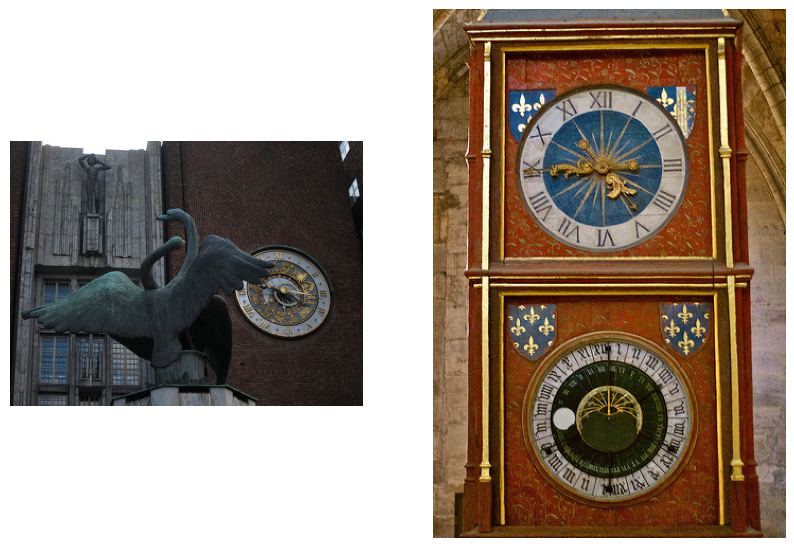

In [6]:
args.test_skip = 5
args.test_amount = 1
args.test_data_path = "./bert_data/test_12-5-21H-43M.json"

qg = QuestionGeneration(args)

prediction_sentence_list = qg.test()
visualize_preds(prediction_sentence_list, qg)

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['bert.pooler.dense.weight', 'cls.seq_relationship.bias', 'bert.pooler.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/alexanderwermuth/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
***Testing...:: 100%|██████████| 1/1 [00:01<00:00,  1.86s/it]


Saving predictions to ./predictions/1-7-15H-31M_predictions.txt 
Training finished! 
-------------------------------------------------------------------------------------- 
:: Pred: what color is the court ground? :: Label: ['what color is the court', 'what color is the shirt', "what is on the man's head"] 
 :: Context: [CLS] a man is playing tennis on a tennis court. [SEP] and [SEP] a man holding a tennis racquet on a tennis court. [SEP] 
 :: Bleu: 75.9836 :: Meteor: 97.6471 
 :: Delta BLEU: 74.01 ::
 :: Original questions :: [['what color is the shirt', 1], ['what color is the court', 2], ["what is on the man's head", 1], ['what is the man doing', -1], ['what is the ground covered with', -1], ['where is the person ', -1], ["what is in the man's hands", -1], ['what is the persion holding', -1], ['what type of shirt is the man wearing', -1], ['what is the man wearing', -1], ['what is the shirt color', 1]]


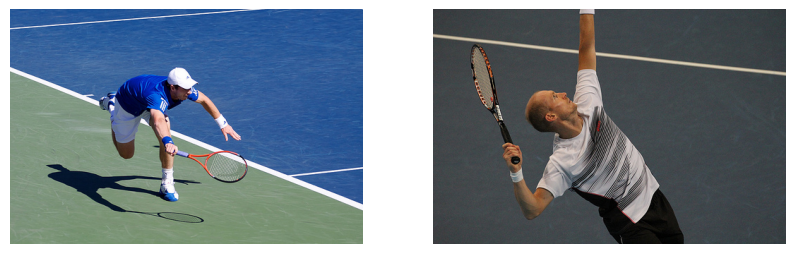

In [ ]:
args.test_skip = 301
args.test_amount = 1
args.test_data_path = "./bert_data/test.json"

qg = QuestionGeneration(args)

prediction_sentence_list = qg.test()
visualize_preds(prediction_sentence_list, qg)


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['bert.pooler.dense.weight', 'cls.seq_relationship.bias', 'bert.pooler.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/alexanderwermuth/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
***Testing...:: 100%|██████████| 30/30 [00:44<00:00,  1.48s/it]

Saving predictions to ./predictions/1-7-15H-31M_predictions.txt 
Training finished! 
-------------------------------------------------------------------------------------- 
:: Pred: what color is the table? :: Label: ['how many children are there ', 'What is the boy holding', 'What is the boy wearing on his face'] 
 :: Context: [CLS] a little boy holding an apple and eating an apple. [SEP] and [SEP] a birthday cake with candles on it [SEP] 
 :: Bleu: 21.3644 :: Meteor: 51.1111 
 :: Delta BLEU: 33.44 ::
 :: Original questions :: [['What is the boy holding', 1], ['What is the boy wearing on his face', 1], ['Where is the boy', 1], ['how many children are there ', 2], ["what color is the man's head", 1], ['what is in the background', 1], ['what is the boy doing', 1], ['what is the boy wearing', 1], ['when was the photo taken', -1], ['how many people are in the photo', 1]]


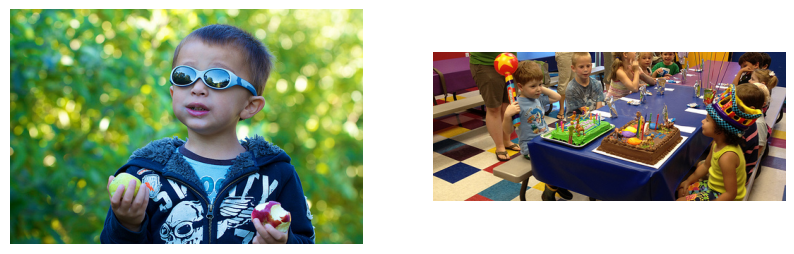

-------------------------------------------------------------------------------------- 
:: Pred: what color is the ground? :: Label: ['how many zebras are there', 'what is in the background', 'What is zebra doing'] 
 :: Context: [CLS] a group of zebras and giraffes in a zoo enclosure. [SEP] and [SEP] a zebra standing in a field of tall grass. [SEP] 
 :: Bleu: 14.0585 :: Meteor: 63.125 
 :: Delta BLEU: 17.97 ::
 :: Original questions :: [['what is the zebra doing', -1], ['how many zebras are there', 1], ['what is in the background', 1], ['where is the zebra', -1], ['what is the color of the land', -1], ['what is the ground covered with', -1], ['how many people are there in the picture', -1], ['What is zebra doing', 1], ['what type of animal is shown', -1], ['when was the picture taken', -1], ['where was this picture taken', -1], ['what is the zebra standing on', -1]]


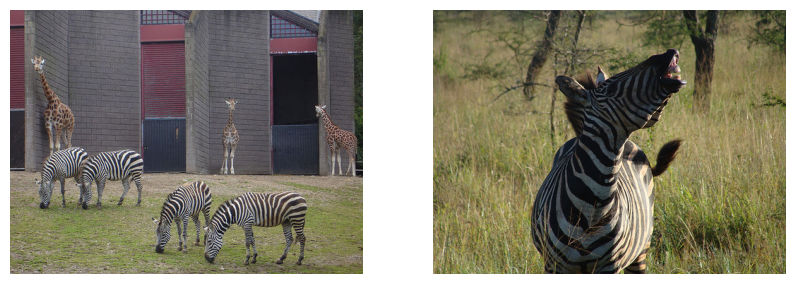

-------------------------------------------------------------------------------------- 
:: Pred: what is the man doing? :: Label: ['how many people are there ', 'how many dogs are there', 'What is man doing'] 
 :: Context: [CLS] two men sitting on a bench with a dog. [SEP] and [SEP] a man standing in the water with dogs. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 91.4634 
 :: Delta BLEU: 37.99 ::
 :: Original questions :: [['how many people are there ', 2], ['how many dogs are there', 2], ['where is the photo taken', -1], ['what is the man wearing', -1], ['What is man doing', 1], ['what is the man holding', 1], ['Where is the man', -1], ['who is wearing a black shirt', -1], ['when was the photo taken', -1], ["what is on the man's face", -1], ['what kind of pants is the man wearing', -1]]


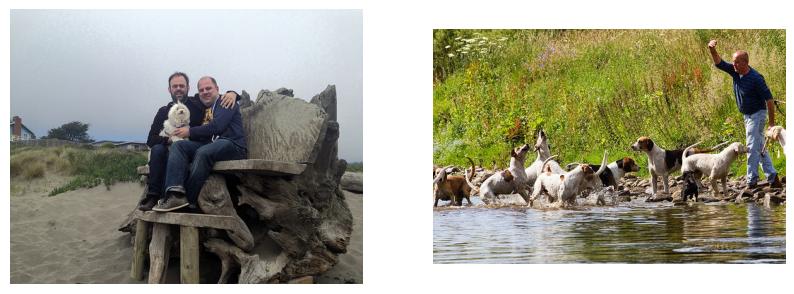

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['what color is the shirt', 'what is the person doing', 'what color is the ground'] 
 :: Context: [CLS] a baseball player holding a bat on a field. [SEP] and [SEP] a man holding a tennis racquet on a tennis court. [SEP] 
 :: Bleu: 53.7285 :: Meteor: 94.902 
 :: Delta BLEU: 53.73 ::
 :: Original questions :: [['what color is the shirt', 1], ['what is the person doing', 1], ['what color is the ground', 1], ['how many shirts are there', -1], ['where is the photo taken', -1], ['what is in the distance', -1], ['what is the man wearing on his head', 1], ['what is the player wearing', -1], ['who is in the photo', -1]]


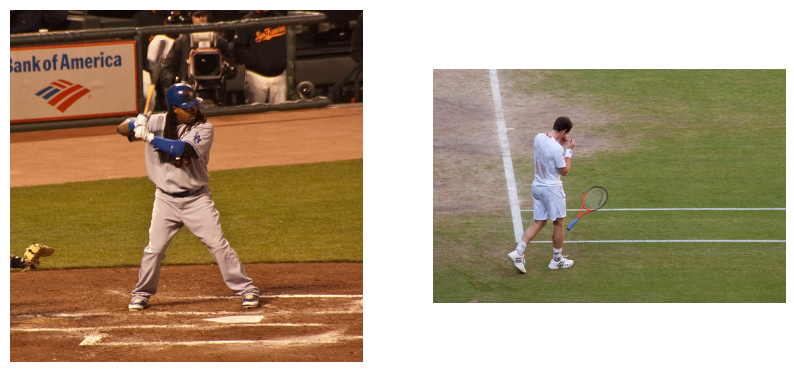

-------------------------------------------------------------------------------------- 
:: Pred: what is the woman doing? :: Label: ['how many people are on the elephant', 'what is in the background', 'who is riding the elephant'] 
 :: Context: [CLS] a woman riding on the back of an elephant. [SEP] and [SEP] a group of people riding on top of an elephant. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 51.1111 
 :: Delta BLEU: 11.82 ::
 :: Original questions :: [['how many people are on the elephant', 2], ['where is the elephant', -1], ["what is on the elephant's back", -1], ['what are the elephants doing', -1], ['what is in the background', 1], ['what is in front of the elephants', -1], ['where is the nose of the elephant', -1], ['what kind of animal is this', -1], ['what color is the elephant', -1], ['who is riding the elephant', 1], ['what are the people riding', -1], ['what is the elephant standing on', -1]]


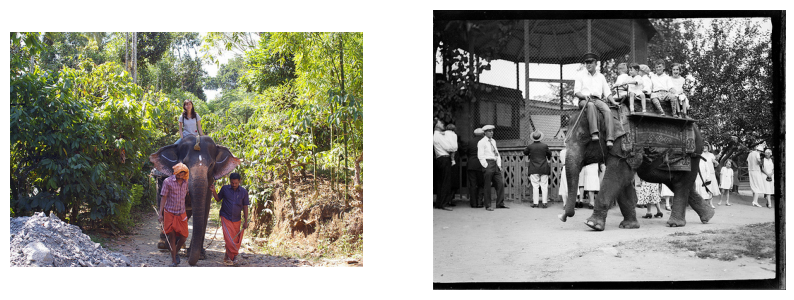

-------------------------------------------------------------------------------------- 
:: Pred: what color is the bus? :: Label: ['what color is the bus', 'how is the weather'] 
 :: Context: [CLS] a bus splashing water on a street. [SEP] and [SEP] a double decker bus driving down a street. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what color is the bus', 2], ['how is the weather', 1], ['what is on the ground', -1], ['how many people are there', -1], ['where is the bus', -1], ['what is the bus doing', -1], ['what is the road made of', -1], ['what is in the distance', -1], ['when was the photo taken', -1], ['what type of bus is this', -1], ['what is on the side of the bus', -1], ['what is behind the bus', -1]]


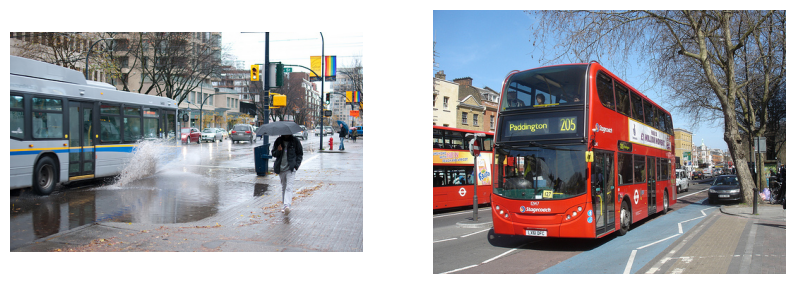

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['what is in front of the television', 'what color is the wall behind the television', 'how many people are there'] 
 :: Context: [CLS] a man and a boy playing a video game [SEP] and [SEP] a small television on a counter in a kitchen. [SEP] 
 :: Bleu: 50.8133 :: Meteor: 48.0769 
 :: Delta BLEU: 29.22 ::
 :: Original questions :: [['what color is the wall behind the television', 1], ['where is the television placed on', -1], ['what color is the television', -1], ['what time is it', -1], ['what is the television on', -1], ['what is in front of the television', 2], ['where is the television', -1], ['how many people are there', 1], ['when was the picture taken', -1], ['where was the picture taken', -1]]


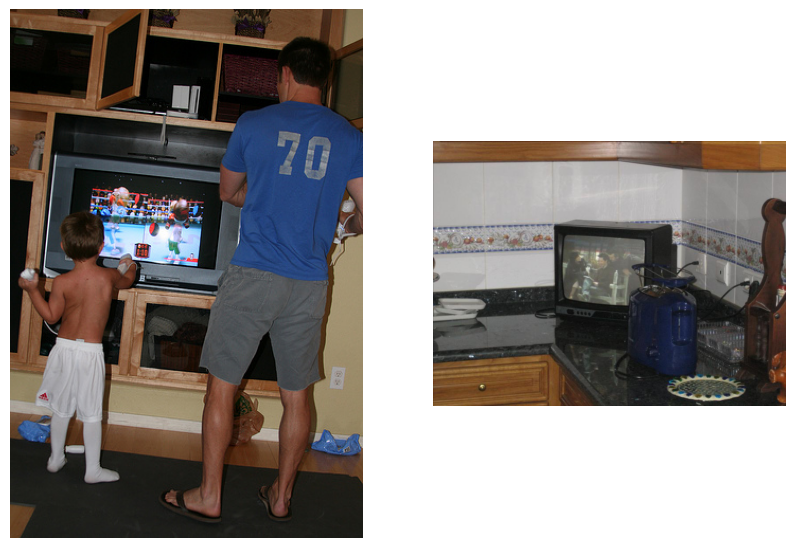

-------------------------------------------------------------------------------------- 
:: Pred: what is the woman wearing? :: Label: ['what animal is on the floor', 'what color is the animal', 'what color is the floor'] 
 :: Context: [CLS] a dog is standing in the kitchen looking at a table. [SEP] and [SEP] a woman in a costume is standing next to a horse. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 51.1111 
 :: Delta BLEU: 28.12 ::
 :: Original questions :: [['what animal is on the floor', 2], ['what color is the animal', 1], ['what color is the floor', 1], ['how many people are there', 1], ['what is on the ground', -1], ['what is the floor made of', -1], ['what is covering the floor', -1], ['how many chairs are there', 1], ['where was the photo taken', 1], ['what type of floor is this', 1], ['what is the ground covered with', 1]]


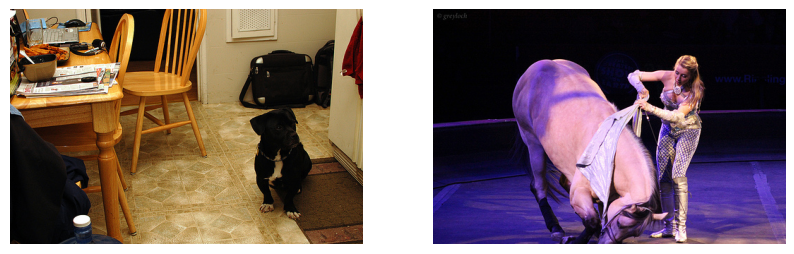

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ["What color is the man's hat", 'how many players are there in the photo'] 
 :: Context: [CLS] a pitcher on the mound throwing a baseball. [SEP] and [SEP] a baseball player swinging a bat at a ball [SEP] 
 :: Bleu: 50.8133 :: Meteor: 83.0 
 :: Delta BLEU: 49.15 ::
 :: Original questions :: [["What color is the man's hat", 2], ['What is the man holding', -1], ['who is in the picture', -1], ["what is on the player's head", -1], ['how many players are there in the photo', 1], ['what is the player doing', -1], ['What is player holding', -1], ['where was the photo taken', -1], ['what sport is being played', -1], ['where is the batter standing', -1], ['who is holding the bat', -1]]


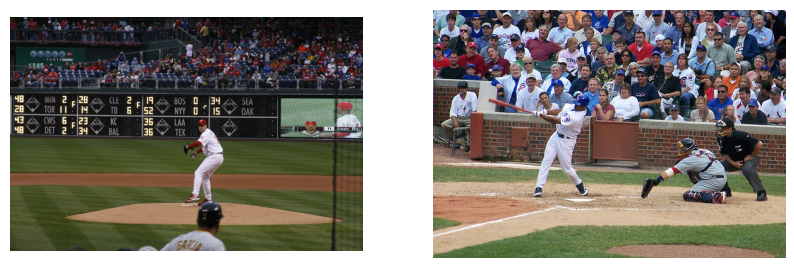

-------------------------------------------------------------------------------------- 
:: Pred: what is the man doing? :: Label: ['what sport is the person playing', "what color is the person's shirt", 'what is the gender of the person'] 
 :: Context: [CLS] a group of people playing a game of frisbee. [SEP] and [SEP] a man playing tennis on a tennis court. [SEP] 
 :: Bleu: 32.5556 :: Meteor: 43.3145 
 :: Delta BLEU: 32.34 ::
 :: Original questions :: [["what color is the person's shirt", 1], ['what is the gender of the person', 1], ['what color is the background', 1], ['how many people are there', -1], ['where is the photo taken', -1], ['what is the persion doing', 1], ['what is the person holding', 1], ['where is the person', -1], ['what is the persion wearing', -1], ['what color is the ground', 1], ['what sport is the person playing', 2]]


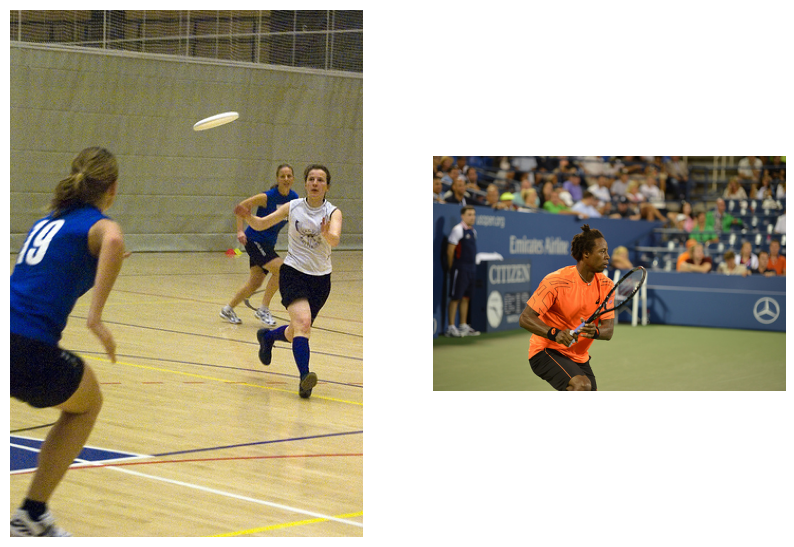

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['what is the person holding', 'what is the guy doing', 'what is the guy standing on '] 
 :: Context: [CLS] a man is doing a trick on a skateboard. [SEP] and [SEP] two men in shorts and t - shirts are on stage. [SEP] 
 :: Bleu: 17.9652 :: Meteor: 50.1089 
 :: Delta BLEU: 28.12 ::
 :: Original questions :: [['what is the guy doing', 1], ['what is the guy standing on ', 1], ['how many people are there', -1], ['what color is the background', 1], ['what is the man wearing on his face', -1], ['what is the person holding', 2], ['what is the person wearing', -1], ['what sport is the man doing', 1], ['where is the picture taken', -1], ['what is the gender of the person', -1], ['who is in the photo', -1], ["what is on the man's head", -1]]


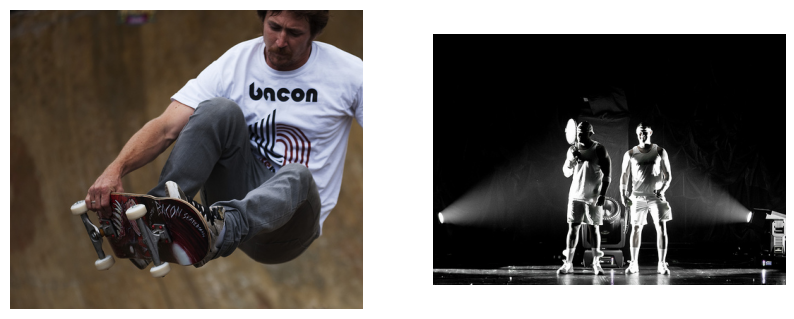

-------------------------------------------------------------------------------------- 
:: Pred: what color is the bus? :: Label: ['what color is the land', 'what color is the truck on the land', 'what is the ground covered with'] 
 :: Context: [CLS] a bus parked in a parking lot with people standing on it. [SEP] and [SEP] a blue truck with a boat on top of it [SEP] 
 :: Bleu: 66.874 :: Meteor: 79.375 
 :: Delta BLEU: 66.87 ::
 :: Original questions :: [['what color is the land', 1], ['how many trucks are there on the land', -1], ['what color is the truck on the land', 1], ['where is picture taken', -1], ['what is the ground covered with', 1], ['where is the land', -1], ['how many people are there', 1], ['when was the photo taken', -1], ['how is the weather', -1], ['what is on the side of the road', -1], ['what kind of vehicle is this', -1]]


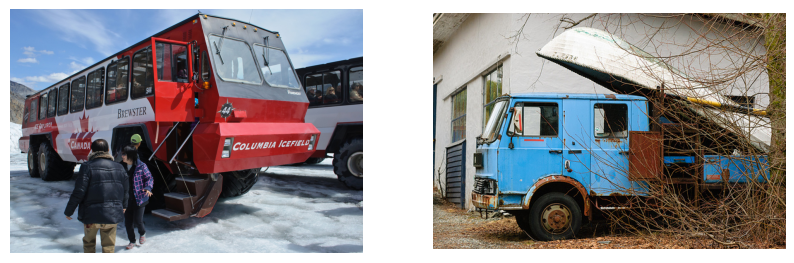

-------------------------------------------------------------------------------------- 
:: Pred: what color is the suitcase? :: Label: ['how many people are there', 'what is the ground covered with', 'where was the picture taken'] 
 :: Context: [CLS] a cat laying on top of a suitcase on a bed. [SEP] and [SEP] a large amount of luggage sitting on the floor. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 43.3145 
 :: Delta BLEU: 23.64 ::
 :: Original questions :: [['what color is the bag', -1], ['how many people are there', 1], ['what is the ground covered with', 1], ['where was the picture taken', 1], ['what is in the background', 1], ['what is next to the suitcase', 1], ['what is the bag made of', -1], ['how many bags are there', -1]]


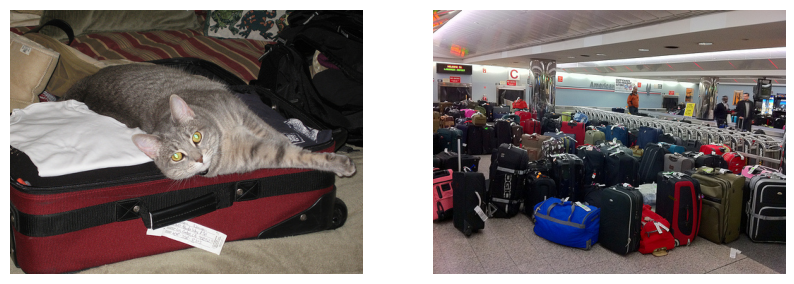

-------------------------------------------------------------------------------------- 
:: Pred: what is the man doing? :: Label: ['what is the man holding', 'how many people are there', 'what is the man doing'] 
 :: Context: [CLS] two men preparing a turkey in a kitchen. [SEP] and [SEP] a man sitting on a couch playing a video game. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 83.76 ::
 :: Original questions :: [['what is the man holding', 2], ['what is the man doing', 1], ['how many people are there', 2], ['What color is the shirt', -1], ['when is this picture taken', -1], ['where is the man', -1], ['what is the man wearing', 1], ['who is in the photo', -1], ["what is on the man's face", 1], ['when was the photo taken', -1], ["what is in the man's hand", 1]]


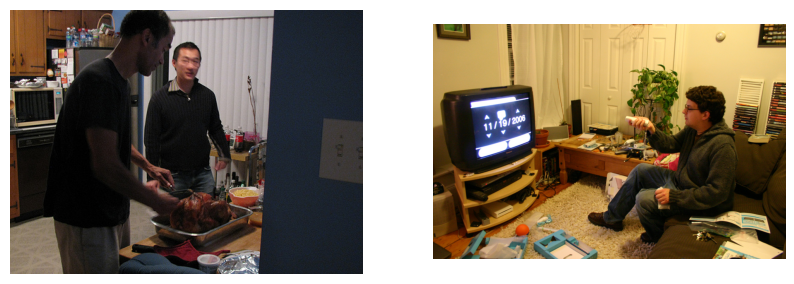

-------------------------------------------------------------------------------------- 
:: Pred: what is the ground covered with? :: Label: ['How many cows are there', 'What is near to the cow', 'what is in the background'] 
 :: Context: [CLS] a cow standing in the middle of a street. [SEP] and [SEP] a couple of cows walking down a street. [SEP] 
 :: Bleu: 17.9652 :: Meteor: 73.5294 
 :: Delta BLEU: 8.12 ::
 :: Original questions :: [['How many cows are there', 2], ['What is near to the cow', 1], ['what color are the cows', -1], ['what is in the background', 1], ['What color is cow', -1], ['what color is the ground the cow standing on', -1], ["what color is the cow's head", -1], ['when was the picture taken', -1], ['what type of animal is shown', -1], ['what are the cows doing', -1], ['where are the cows', -1], ["what is on the cow's head", -1], ['what color is the cow', -1]]


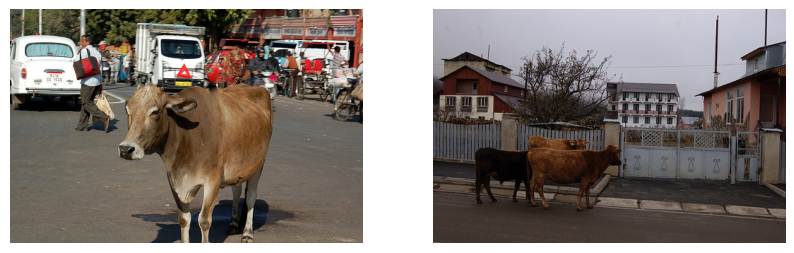

-------------------------------------------------------------------------------------- 
:: Pred: what color is the bed? :: Label: ['what color is the floor', 'what is the floor made of', 'what pattern is the floor'] 
 :: Context: [CLS] a bed with a canopy and a canopy over it. [SEP] and [SEP] a white vase sitting on top of a wooden floor. [SEP] 
 :: Bleu: 66.874 :: Meteor: 79.375 
 :: Delta BLEU: 66.87 ::
 :: Original questions :: [['what color is the floor', 1], ['what is the floor made of', 1], ['what pattern is the floor', 1], ['how many people are there', -1], ['what is on the ground', 1], ['what type of floor is this', 1], ['what is the pattern on the floor', 1]]


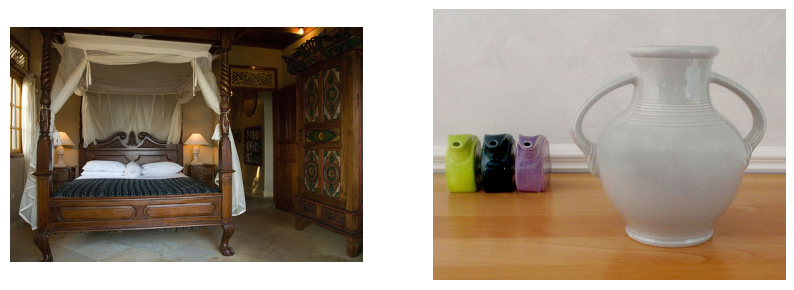

-------------------------------------------------------------------------------------- 
:: Pred: what color is the towel? :: Label: ['what is the color of the towel', 'who is on the towel', 'what color is the towel on the right'] 
 :: Context: [CLS] a bathroom with a sink, mirror, and shower. [SEP] and [SEP] a towel rack with a teddy bear and a towel. [SEP] 
 :: Bleu: 100.0 :: Meteor: 57.9221 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what is the color of the towel', 1], ['what is on the wall', -1], ['what color is the wall', -1], ['what room is the towel in', -1], ['who is on the towel', 1], ['what is behind the towel', -1], ['what is the towel put on ', -1], ['how many towels are there', -1], ['where was the photo taken', -1], ['where are the towels', -1], ['what color is the towel on the right', 1]]


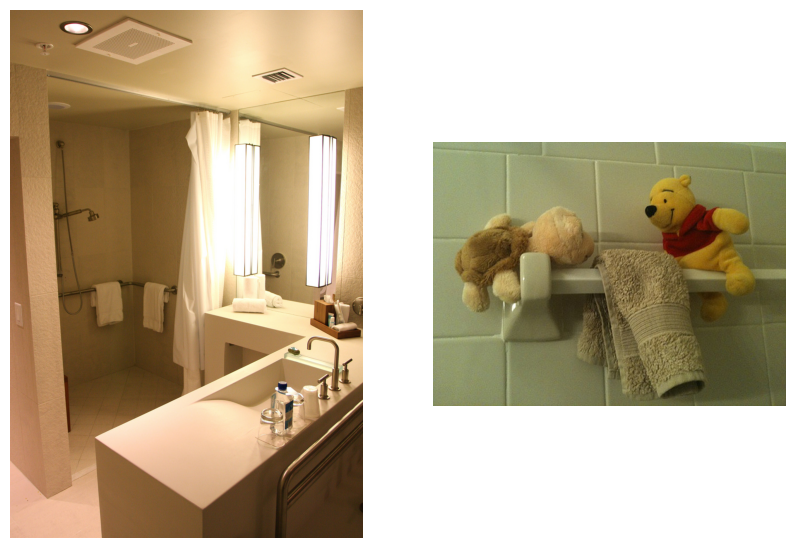

-------------------------------------------------------------------------------------- 
:: Pred: what color is the woman's shirt? :: Label: ['What is the gender of person', "What color is person's shirt", 'What is person holding'] 
 :: Context: [CLS] a man in a blue shirt and tie posing for a picture. [SEP] and [SEP] a woman wearing sunglasses holding a yellow umbrella. [SEP] 
 :: Bleu: 22.9575 :: Meteor: 73.5294 
 :: Delta BLEU: 20.66 ::
 :: Original questions :: [['What is the gender of person', 2], ["What color is person's shirt", 1], ['What is person holding', 1], ['what is the persion holding', 1], ['how many people are there', -1], ['what is the person wearing', 1]]


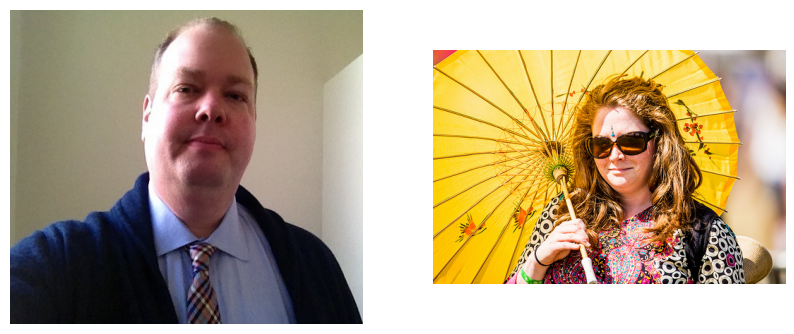

-------------------------------------------------------------------------------------- 
:: Pred: what color is the table? :: Label: ['what is the shape of the cake', 'what color is the table', 'how many people are there in the picture'] 
 :: Context: [CLS] a little girl sitting in front of a chocolate cake. [SEP] and [SEP] two cakes sitting on a table with a knife and fork. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['how many cakes are there', -1], ['what is the shape of the cake', 1], ['what color is the table', 1], ['what is on top of the cake', -1], ['What is cake on', -1], ['what is on the cake', -1], ['how many people are there in the picture', 1], ['where is the cake', -1], ['what is the cake made of', -1], ['what kind of cake is this', -1], ['what is the cake', -1]]


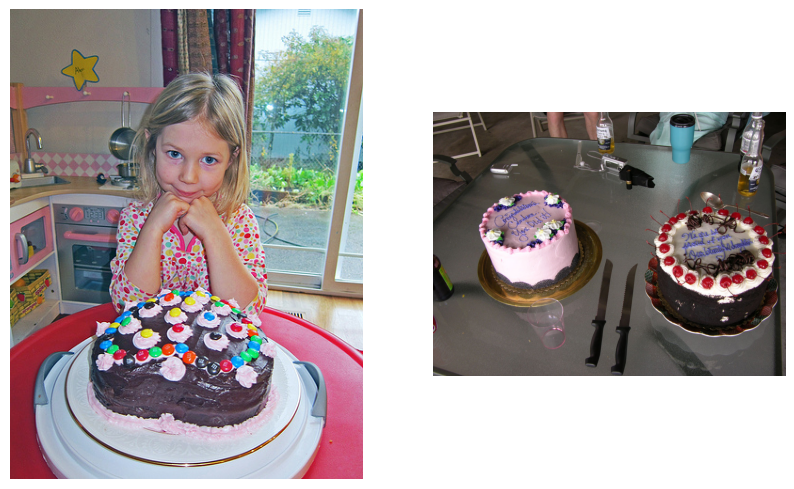

-------------------------------------------------------------------------------------- 
:: Pred: what color is the table? :: Label: ['how many people are in the picture', 'what is the floor made of', 'what shape is the chair'] 
 :: Context: [CLS] a man standing in a living room holding a wii controller. [SEP] and [SEP] a kitchen with a table and chairs and a table. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 51.1111 
 :: Delta BLEU: 23.64 ::
 :: Original questions :: [['what shape is the chair', 1], ['what is the floor the chair on made of', -1], ['what is on the chair', 1], ['how many chairs are there', 1], ['Where is the chair', -1], ['what is in the room', -1], ['how many people are in the picture', 2], ['what is the floor made of', 2]]


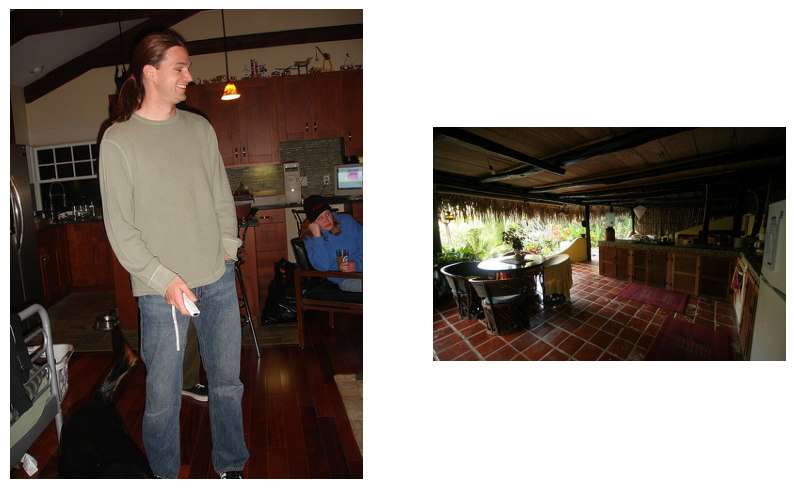

-------------------------------------------------------------------------------------- 
:: Pred: what color is the ground? :: Label: ['what color is the ground', 'what color is the plane', 'how many planes are in the picture'] 
 :: Context: [CLS] a blue and white airplane is on the runway. [SEP] and [SEP] a large jetliner flying over an airport. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what color is the plane', 1], ['what color is the ground', 2], ['how many planes are in the picture', 1], ['when is the picture taken', -1], ['where is the plane', -1], ['what is the ground covered with', 1], ["what color is the plane's tail", 1], ['what is the plane doing', -1], ['what is in the background', -1], ['where was this picture taken', -1], ['what is on the ground', -1]]


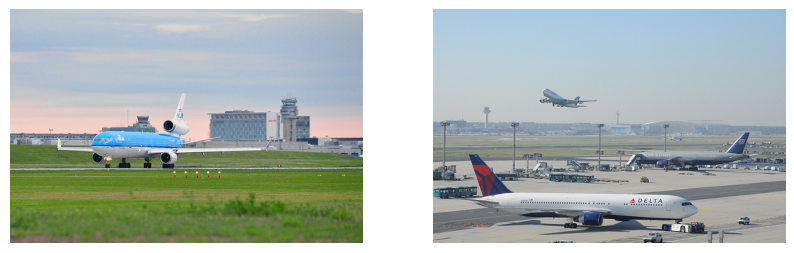

-------------------------------------------------------------------------------------- 
:: Pred: what color is the table? :: Label: ['what color is the chair', 'what is on the chair', 'how many people are in the picture'] 
 :: Context: [CLS] a man sitting at a desk using a laptop. [SEP] and [SEP] a room with a row of tables and a laptop on top of it. [SEP] 
 :: Bleu: 66.874 :: Meteor: 79.375 
 :: Delta BLEU: 66.87 ::
 :: Original questions :: [['what is the chair made of', -1], ['what color is the chair', 2], ['what color is the ground', -1], ['how many chairs are there in the photo', -1], ['where is the chair', -1], ['what is on the chair', 1], ['how many people are in the picture', 1], ['what is the floor made of', -1], ['what is next to the chair', -1], ['what material is the chair made of', -1], ['where are the chairs', -1], ['what are the chairs made of', -1]]


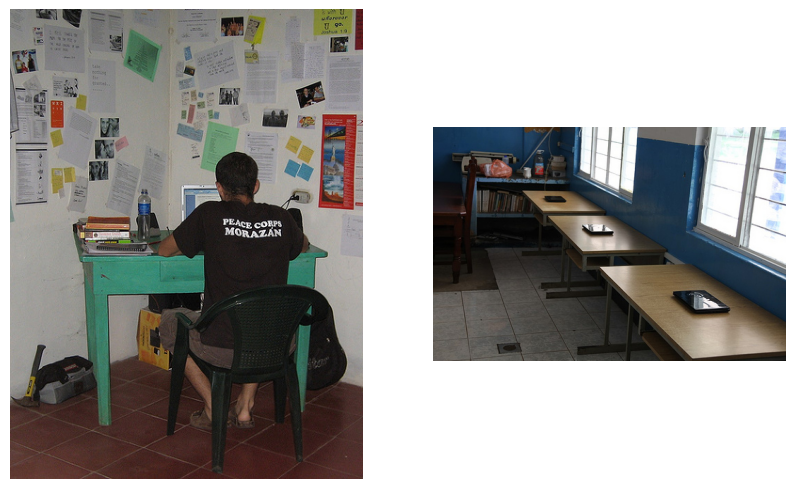

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['where is the photo taken', 'How many people are there', 'What is man holding'] 
 :: Context: [CLS] a man holding an umbrella in the rain. [SEP] and [SEP] a man and woman smiling at a formal dinner. [SEP] 
 :: Bleu: 16.2334 :: Meteor: 36.7647 
 :: Delta BLEU: 9.65 ::
 :: Original questions :: [["What color is man's shirt", -1], ['How many people are there', 1], ['What is man holding', 1], ['where is the photo taken', 2], ['where are the people staying', 1], ['what is the persion holding', 1], ['what kind of shirt is the man wearing', 1], ["what is on the man's face", -1]]


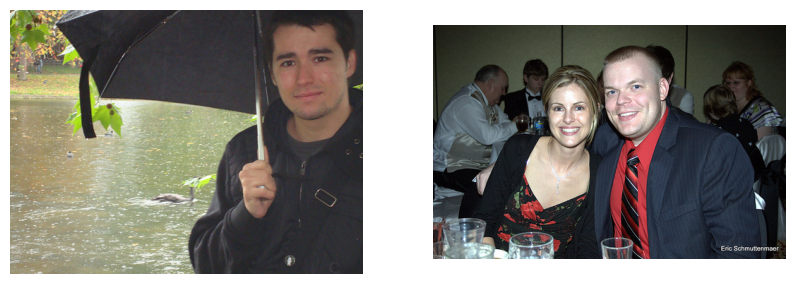

-------------------------------------------------------------------------------------- 
:: Pred: what color is the building? :: Label: ['When is photo taken', 'what time is it', 'how many cars are there on the street'] 
 :: Context: [CLS] a street sign with a sticker on it [SEP] and [SEP] a red stop light at night with cars passing by. [SEP] 
 :: Bleu: 14.0585 :: Meteor: 24.3902 
 :: Delta BLEU: 13.43 ::
 :: Original questions :: [['When is photo taken', 2], ['How mant people are there', -1], ['what is in front of the car', -1], ['how is the weather', -1], ['what time is it', 2], ['how many cars are there on the street', 1], ['where was this photo taken', -1], ['what is the road made of', -1], ['where are the cars', -1], ['what is on the ground', -1], ['when was the picture taken', 1]]


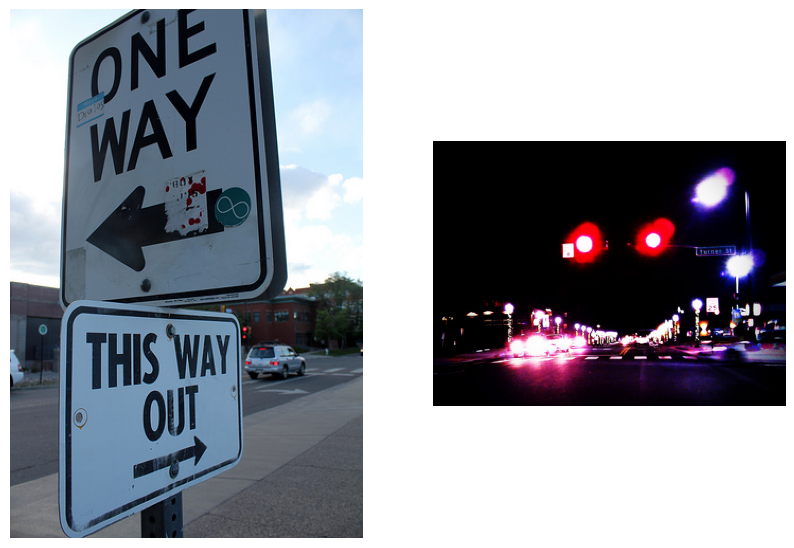

-------------------------------------------------------------------------------------- 
:: Pred: what is the ground covered with? :: Label: ['what is the woman wearing', "what is on woman's face", 'how many people are there'] 
 :: Context: [CLS] a young boy throwing a frisbee in a park. [SEP] and [SEP] a dog catching a frisbee in its mouth. [SEP] 
 :: Bleu: 30.2138 :: Meteor: 57.7342 
 :: Delta BLEU: 30.21 ::
 :: Original questions :: [['who is playing the disk', -1], ['what is the persion sitting on', -1], ["what is on woman's face", 1], ['how many people are there', 1], ['what is the woman doing', -1], ['what is the woman holding', 1], ['when was this photo taken', -1], ['what kind of pants is the woman wearing', -1], ['where was the photo taken', -1], ['who is wearing a white shirt', -1], ['what is the woman wearing', 2]]


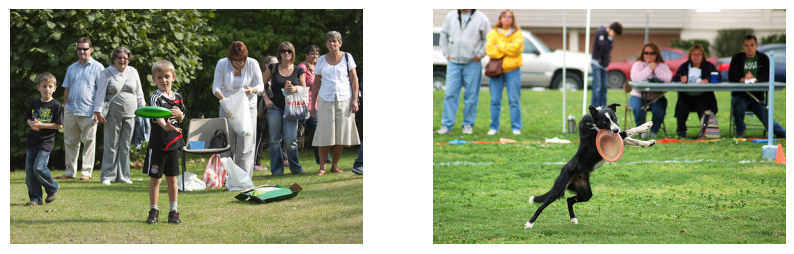

-------------------------------------------------------------------------------------- 
:: Pred: what is the man holding? :: Label: ['what is the woman wearing', 'what is the woman doing', 'where is the woman'] 
 :: Context: [CLS] a person riding a horse in a corral. [SEP] and [SEP] a man pulling a boat on the beach. [SEP] 
 :: Bleu: 39.7635 :: Meteor: 58.8889 
 :: Delta BLEU: 50.81 ::
 :: Original questions :: [['what is the woman wearing', 1], ['what is the woman doing', 1], ['how many people are there', -1], ['where is the woman', 1], ['what gesture is the woman', -1], ['what is the woman holding', 1], ['when was the photo taken', -1], ['who is in the picture', -1], ['what is on the back of the woman', 1], ['what is the woman on', 1]]


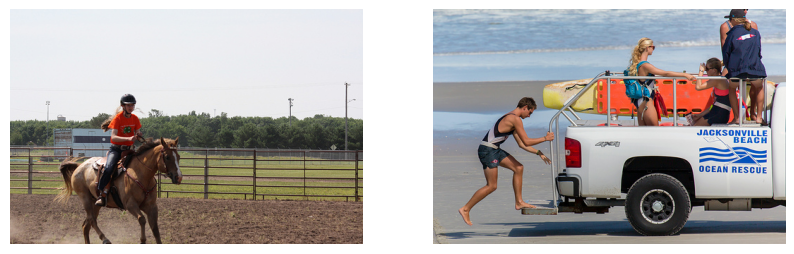

-------------------------------------------------------------------------------------- 
:: Pred: what color is the bench? :: Label: ['what color is the bench', 'what is the bench on', 'what is behind the bench'] 
 :: Context: [CLS] a blue book on a bench [SEP] and [SEP] a little boy jumping on a bench in a park. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what color is the bench', 2], ['what is the bench on', 1], ['who is on the bench', -1], ['when is this photo taken', -1], ['where is the bench', -1], ['what is behind the bench', 1], ['what is the bench made of', -1], ['how many benches are there', -1], ['what is on the bench', 1], ['what is made of wood', -1], ['what is in front of the bench', -1], ['what is under the bench', 1]]


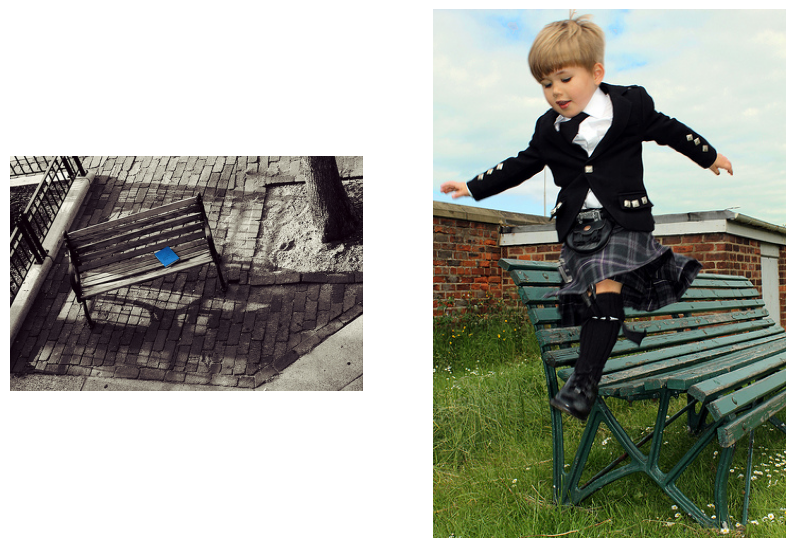

-------------------------------------------------------------------------------------- 
:: Pred: what color is the table? :: Label: ['where is the picture taken', "what is on the man's face", 'what color is the shirt'] 
 :: Context: [CLS] a man is using a laptop in a kitchen. [SEP] and [SEP] two men sitting at a table with a plate of food. [SEP] 
 :: Bleu: 66.874 :: Meteor: 79.375 
 :: Delta BLEU: 41.33 ::
 :: Original questions :: [['what color is the shirt', 1], ['where is the picture taken', 2], ['how many faces are there in the picture', 1], ['What is the man doing', 1], ['what is the person holding', 1], ['where is the person', 1], ['how many people are there', 1], ["what color is the man's shirt", 1], ["what is on the man's face", 2], ['who is in the photo', -1]]


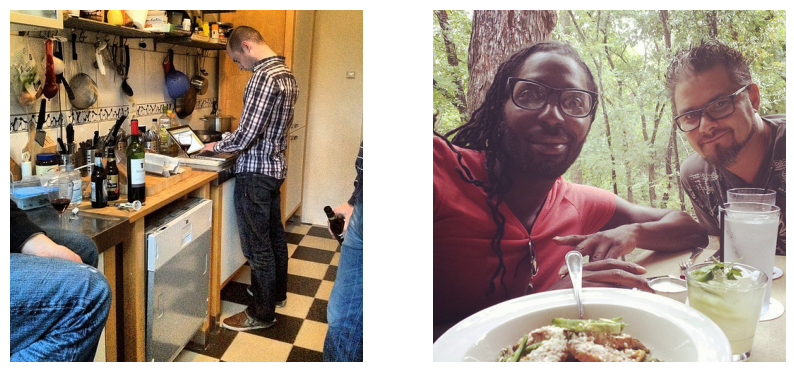

-------------------------------------------------------------------------------------- 
:: Pred: what color is the woman's shirt? :: Label: ["what color is the woman's hair", 'where is the woman', 'how many people are there in the picture'] 
 :: Context: [CLS] a restaurant with a menu on the wall. [SEP] and [SEP] a woman laying on a bed with a pillow. [SEP] 
 :: Bleu: 75.9836 :: Meteor: 83.0 
 :: Delta BLEU: 75.98 ::
 :: Original questions :: [["what color is the woman's hair", 2], ['where is the woman', 2], ['what color is the background', 1], ['How many people are there', 1], ['What is woman holding', -1], ['what is the woman wearing', -1], ["what is the woman's posture", 1], ['who is in the photo', 1], ['what is the persion doing', 1], ['how many people are there in the picture', 2]]


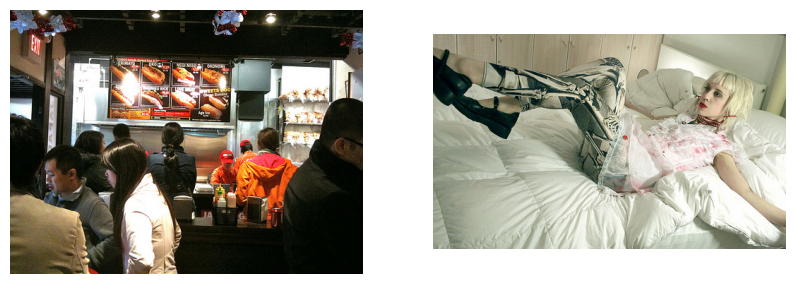

-------------------------------------------------------------------------------------- 
:: Pred: what is on the clock? :: Label: ['what shape is the clock', 'what is the clock on', 'what color is the clock'] 
 :: Context: [CLS] a door is open [SEP] and [SEP] an apple with a clock attached to it. [SEP] 
 :: Bleu: 31.9472 :: Meteor: 89.2 
 :: Delta BLEU: 37.00 ::
 :: Original questions :: [['what is the clock on', 1], ['what shape is the clock', 2], ['what color is the clock', 1], ['how many people are there in the picture', -1], ['when is this picture taken', -1], ['where is the clock', 1], ['what time is showed on the clock', 1], ['what is the clock made of', 1], ['what time is it', 1], ['what is in the background', -1]]


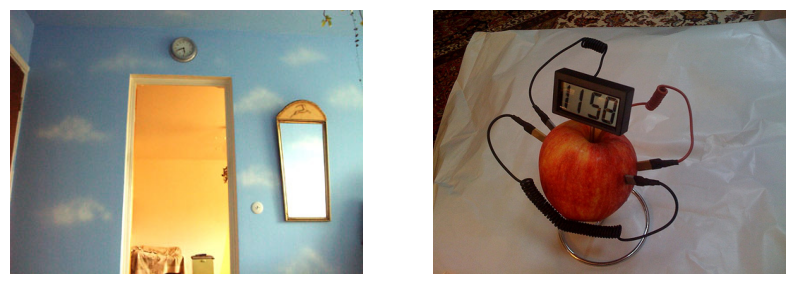

BLEU score:  49.2045
Average METEOR score:  69.7403
Delta BLEU score:  48.0253


In [ ]:
args.test_skip = 1000
args.test_amount = 30
args.timestamp = "1-4-10H-36M"
args.num_train_epochs = 5

qg = QuestionGeneration(args)

prediction_sentence_list = qg.test()
visualize_preds(prediction_sentence_list, qg)

bleu_score, avg_meteor_Score, delta_bleu_score = qg.eval_prediction(prediction_sentence_list)

print("BLEU score: ", bleu_score)
print("Average METEOR score: ", avg_meteor_Score)
print("Delta BLEU score: ", delta_bleu_score)

## Generating VDQG from two images using Approach best using GIT-BASE captions. Trained on 80%

In [9]:
args.timestamp = "1-4-18H-2M"
args.num_train_epochs = 10

qg = QuestionGeneration(args)

prediction_sentence_list = qg.test()

Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['cls.seq_relationship.weight', 'bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertForMaskedLM from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertForMaskedLM from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/alexanderwermuth/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
***Testing...:: 100%|██████████| 30/30 [00:44<00:00,  1.47s/it]

Saving predictions to ./predictions/1-7-18H-7M_predictions.txt 
Training finished! 


-------------------------------------------------------------------------------------- 
:: Pred: what color is the boy's shirt? :: Label: ['how many children are there ', 'What is the boy holding', 'What is the boy wearing on his face'] 
 :: Context: [CLS] a little boy holding an apple and eating an apple. [SEP] and [SEP] a birthday cake with candles on it [SEP] 
 :: Bleu: 16.2334 :: Meteor: 50.1089 
 :: Delta BLEU: 25.41 ::
 :: Original questions :: [['What is the boy holding', 1], ['What is the boy wearing on his face', 1], ['Where is the boy', 1], ['how many children are there ', 2], ["what color is the man's head", 1], ['what is in the background', 1], ['what is the boy doing', 1], ['what is the boy wearing', 1], ['when was the photo taken', -1], ['how many people are in the photo', 1]]


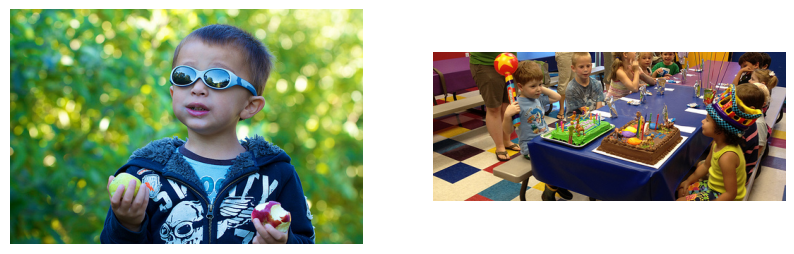

-------------------------------------------------------------------------------------- 
:: Pred: how many animals are there? :: Label: ['how many zebras are there', 'what is in the background', 'What is zebra doing'] 
 :: Context: [CLS] a group of zebras and giraffes in a zoo enclosure. [SEP] and [SEP] a zebra standing in a field of tall grass. [SEP] 
 :: Bleu: 30.2138 :: Meteor: 75.0 
 :: Delta BLEU: 42.73 ::
 :: Original questions :: [['what is the zebra doing', -1], ['how many zebras are there', 1], ['what is in the background', 1], ['where is the zebra', -1], ['what is the color of the land', -1], ['what is the ground covered with', -1], ['how many people are there in the picture', -1], ['What is zebra doing', 1], ['what type of animal is shown', -1], ['when was the picture taken', -1], ['where was this picture taken', -1], ['what is the zebra standing on', -1]]


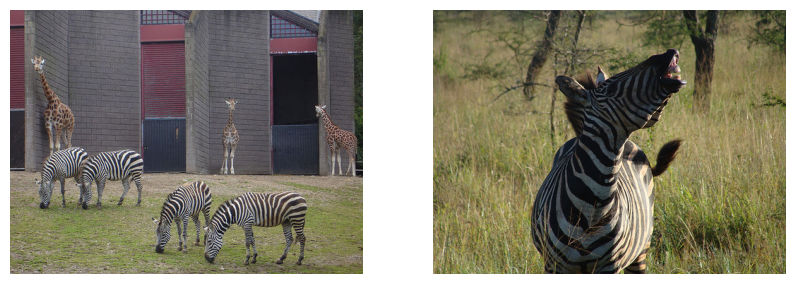

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['how many people are there ', 'how many dogs are there', 'What is man doing'] 
 :: Context: [CLS] two men sitting on a bench with a dog. [SEP] and [SEP] a man standing in the water with dogs. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['how many people are there ', 2], ['how many dogs are there', 2], ['where is the photo taken', -1], ['what is the man wearing', -1], ['What is man doing', 1], ['what is the man holding', 1], ['Where is the man', -1], ['who is wearing a black shirt', -1], ['when was the photo taken', -1], ["what is on the man's face", -1], ['what kind of pants is the man wearing', -1]]


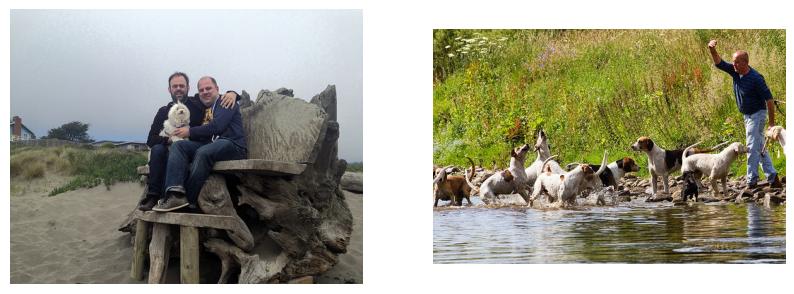

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['what color is the shirt', 'what is the person doing', 'what color is the ground'] 
 :: Context: [CLS] a baseball player holding a bat on a field. [SEP] and [SEP] a man holding a tennis racquet on a tennis court. [SEP] 
 :: Bleu: 53.7285 :: Meteor: 94.902 
 :: Delta BLEU: 53.73 ::
 :: Original questions :: [['what color is the shirt', 1], ['what is the person doing', 1], ['what color is the ground', 1], ['how many shirts are there', -1], ['where is the photo taken', -1], ['what is in the distance', -1], ['what is the man wearing on his head', 1], ['what is the player wearing', -1], ['who is in the photo', -1]]


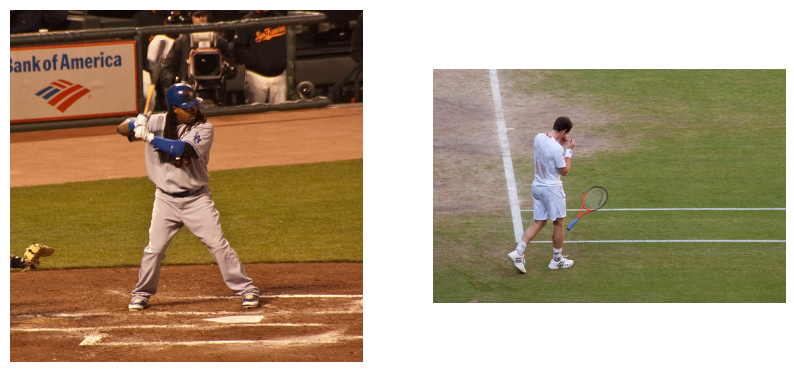

-------------------------------------------------------------------------------------- 
:: Pred: how many elephants are there? :: Label: ['how many people are on the elephant', 'what is in the background', 'who is riding the elephant'] 
 :: Context: [CLS] a woman riding on the back of an elephant. [SEP] and [SEP] a group of people riding on top of an elephant. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 46.4154 
 :: Delta BLEU: 22.59 ::
 :: Original questions :: [['how many people are on the elephant', 2], ['where is the elephant', -1], ["what is on the elephant's back", -1], ['what are the elephants doing', -1], ['what is in the background', 1], ['what is in front of the elephants', -1], ['where is the nose of the elephant', -1], ['what kind of animal is this', -1], ['what color is the elephant', -1], ['who is riding the elephant', 1], ['what are the people riding', -1], ['what is the elephant standing on', -1]]


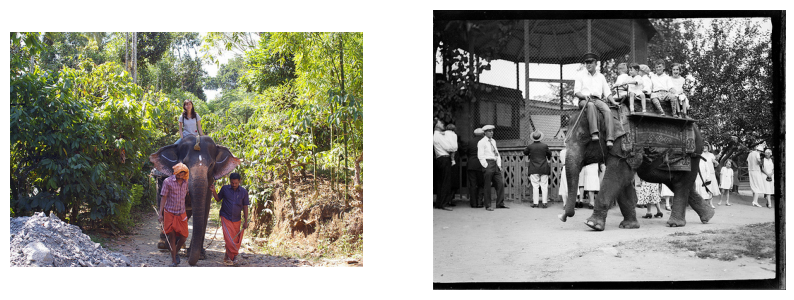

-------------------------------------------------------------------------------------- 
:: Pred: how many buses are there? :: Label: ['what color is the bus', 'how is the weather'] 
 :: Context: [CLS] a bus splashing water on a street. [SEP] and [SEP] a double decker bus driving down a street. [SEP] 
 :: Bleu: 10.6822 :: Meteor: 12.1951 
 :: Delta BLEU: 5.34 ::
 :: Original questions :: [['what color is the bus', 2], ['how is the weather', 1], ['what is on the ground', -1], ['how many people are there', -1], ['where is the bus', -1], ['what is the bus doing', -1], ['what is the road made of', -1], ['what is in the distance', -1], ['when was the photo taken', -1], ['what type of bus is this', -1], ['what is on the side of the bus', -1], ['what is behind the bus', -1]]


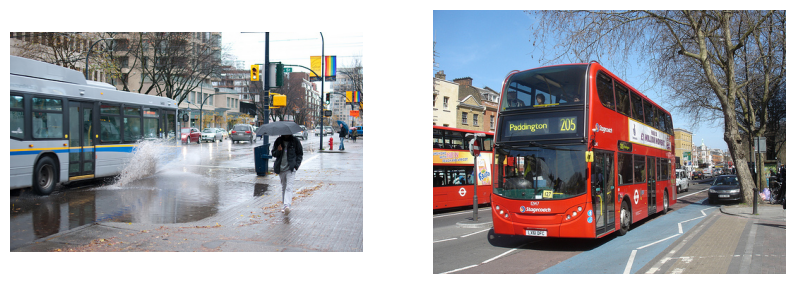

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['what is in front of the television', 'what color is the wall behind the television', 'how many people are there'] 
 :: Context: [CLS] a man and a boy playing a video game [SEP] and [SEP] a small television on a counter in a kitchen. [SEP] 
 :: Bleu: 50.8133 :: Meteor: 48.0769 
 :: Delta BLEU: 29.22 ::
 :: Original questions :: [['what color is the wall behind the television', 1], ['where is the television placed on', -1], ['what color is the television', -1], ['what time is it', -1], ['what is the television on', -1], ['what is in front of the television', 2], ['where is the television', -1], ['how many people are there', 1], ['when was the picture taken', -1], ['where was the picture taken', -1]]


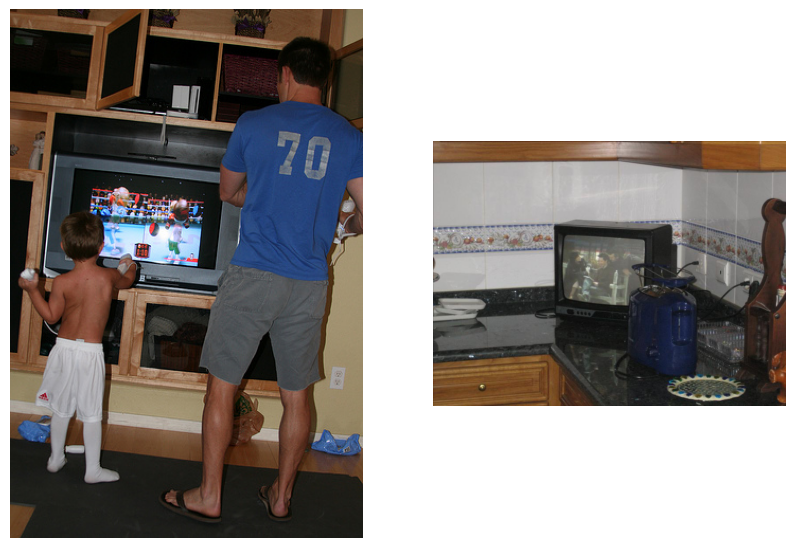

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['what animal is on the floor', 'what color is the animal', 'what color is the floor'] 
 :: Context: [CLS] a dog is standing in the kitchen looking at a table. [SEP] and [SEP] a woman in a costume is standing next to a horse. [SEP] 
 :: Bleu: 5.3411 :: Meteor: 0.0 
 :: Delta BLEU: 50.00 ::
 :: Original questions :: [['what animal is on the floor', 2], ['what color is the animal', 1], ['what color is the floor', 1], ['how many people are there', 1], ['what is on the ground', -1], ['what is the floor made of', -1], ['what is covering the floor', -1], ['how many chairs are there', 1], ['where was the photo taken', 1], ['what type of floor is this', 1], ['what is the ground covered with', 1]]


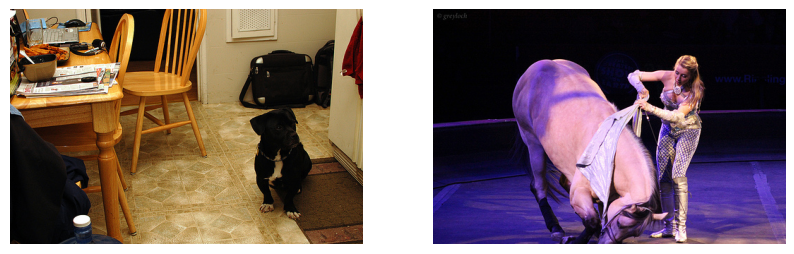

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ["What color is the man's hat", 'how many players are there in the photo'] 
 :: Context: [CLS] a pitcher on the mound throwing a baseball. [SEP] and [SEP] a baseball player swinging a bat at a ball [SEP] 
 :: Bleu: 50.8133 :: Meteor: 83.0 
 :: Delta BLEU: 49.15 ::
 :: Original questions :: [["What color is the man's hat", 2], ['What is the man holding', -1], ['who is in the picture', -1], ["what is on the player's head", -1], ['how many players are there in the photo', 1], ['what is the player doing', -1], ['What is player holding', -1], ['where was the photo taken', -1], ['what sport is being played', -1], ['where is the batter standing', -1], ['who is holding the bat', -1]]


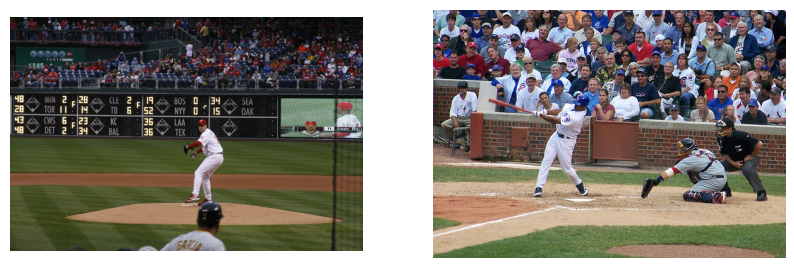

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['what sport is the person playing', "what color is the person's shirt", 'what is the gender of the person'] 
 :: Context: [CLS] a group of people playing a game of frisbee. [SEP] and [SEP] a man playing tennis on a tennis court. [SEP] 
 :: Bleu: 53.7285 :: Meteor: 80.6667 
 :: Delta BLEU: 32.47 ::
 :: Original questions :: [["what color is the person's shirt", 1], ['what is the gender of the person', 1], ['what color is the background', 1], ['how many people are there', -1], ['where is the photo taken', -1], ['what is the persion doing', 1], ['what is the person holding', 1], ['where is the person', -1], ['what is the persion wearing', -1], ['what color is the ground', 1], ['what sport is the person playing', 2]]


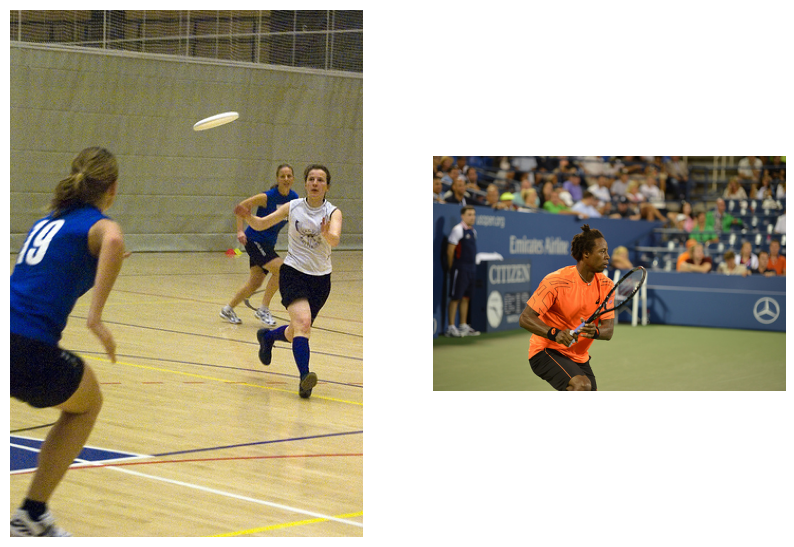

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['what is the person holding', 'what is the guy doing', 'what is the guy standing on '] 
 :: Context: [CLS] a man is doing a trick on a skateboard. [SEP] and [SEP] two men in shorts and t - shirts are on stage. [SEP] 
 :: Bleu: 5.3411 :: Meteor: 0.0 
 :: Delta BLEU: 5.34 ::
 :: Original questions :: [['what is the guy doing', 1], ['what is the guy standing on ', 1], ['how many people are there', -1], ['what color is the background', 1], ['what is the man wearing on his face', -1], ['what is the person holding', 2], ['what is the person wearing', -1], ['what sport is the man doing', 1], ['where is the picture taken', -1], ['what is the gender of the person', -1], ['who is in the photo', -1], ["what is on the man's head", -1]]


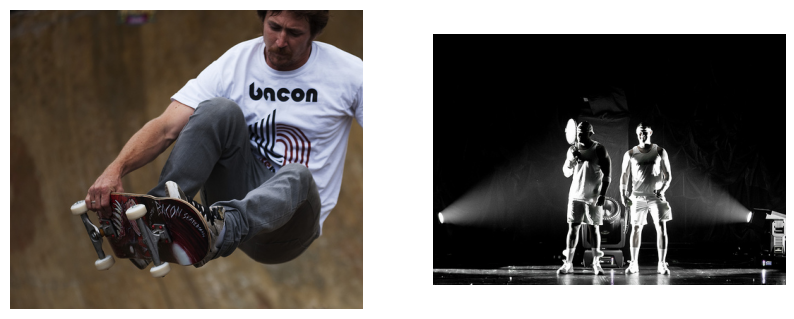

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['what color is the land', 'what color is the truck on the land', 'what is the ground covered with'] 
 :: Context: [CLS] a bus parked in a parking lot with people standing on it. [SEP] and [SEP] a blue truck with a boat on top of it [SEP] 
 :: Bleu: 5.3411 :: Meteor: 0.0 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what color is the land', 1], ['how many trucks are there on the land', -1], ['what color is the truck on the land', 1], ['where is picture taken', -1], ['what is the ground covered with', 1], ['where is the land', -1], ['how many people are there', 1], ['when was the photo taken', -1], ['how is the weather', -1], ['what is on the side of the road', -1], ['what kind of vehicle is this', -1]]


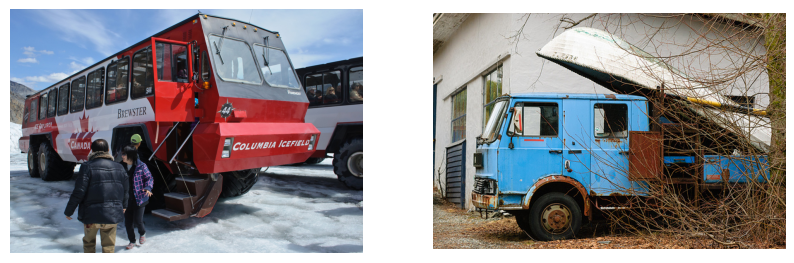

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['how many people are there', 'what is the ground covered with', 'where was the picture taken'] 
 :: Context: [CLS] a cat laying on top of a suitcase on a bed. [SEP] and [SEP] a large amount of luggage sitting on the floor. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what color is the bag', -1], ['how many people are there', 1], ['what is the ground covered with', 1], ['where was the picture taken', 1], ['what is in the background', 1], ['what is next to the suitcase', 1], ['what is the bag made of', -1], ['how many bags are there', -1]]


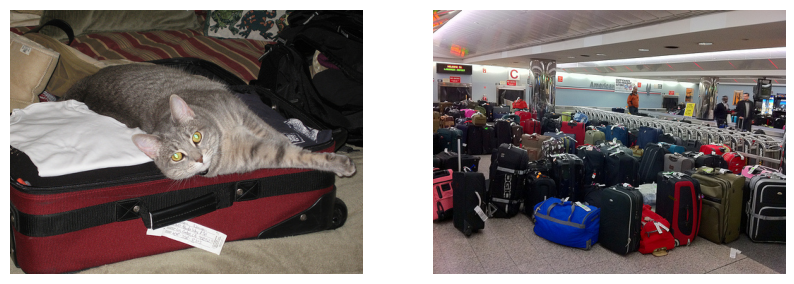

-------------------------------------------------------------------------------------- 
:: Pred: what is the man doing? :: Label: ['what is the man holding', 'how many people are there', 'what is the man doing'] 
 :: Context: [CLS] two men preparing a turkey in a kitchen. [SEP] and [SEP] a man sitting on a couch playing a video game. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 83.76 ::
 :: Original questions :: [['what is the man holding', 2], ['what is the man doing', 1], ['how many people are there', 2], ['What color is the shirt', -1], ['when is this picture taken', -1], ['where is the man', -1], ['what is the man wearing', 1], ['who is in the photo', -1], ["what is on the man's face", 1], ['when was the photo taken', -1], ["what is in the man's hand", 1]]


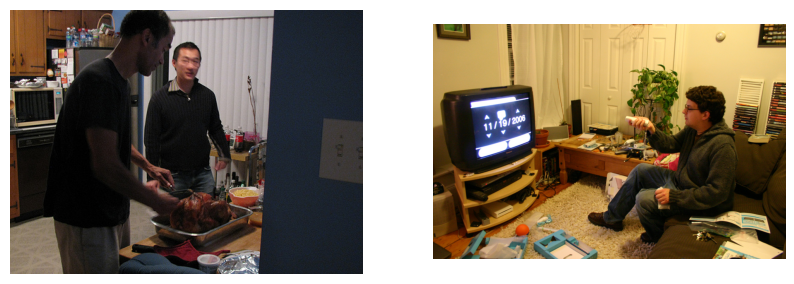

-------------------------------------------------------------------------------------- 
:: Pred: how many cows are there? :: Label: ['How many cows are there', 'What is near to the cow', 'what is in the background'] 
 :: Context: [CLS] a cow standing in the middle of a street. [SEP] and [SEP] a couple of cows walking down a street. [SEP] 
 :: Bleu: 66.874 :: Meteor: 99.6 
 :: Delta BLEU: 66.87 ::
 :: Original questions :: [['How many cows are there', 2], ['What is near to the cow', 1], ['what color are the cows', -1], ['what is in the background', 1], ['What color is cow', -1], ['what color is the ground the cow standing on', -1], ["what color is the cow's head", -1], ['when was the picture taken', -1], ['what type of animal is shown', -1], ['what are the cows doing', -1], ['where are the cows', -1], ["what is on the cow's head", -1], ['what color is the cow', -1]]


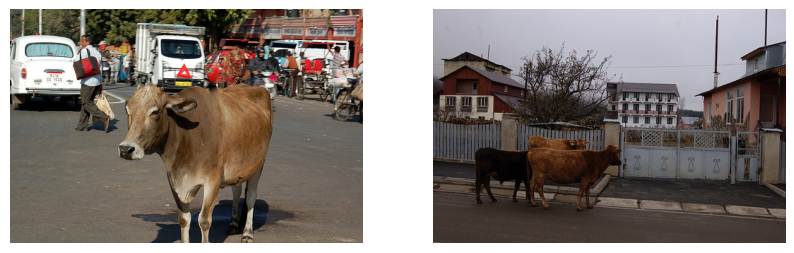

-------------------------------------------------------------------------------------- 
:: Pred: how many chairs are there? :: Label: ['what color is the floor', 'what is the floor made of', 'what pattern is the floor'] 
 :: Context: [CLS] a bed with a canopy and a canopy over it. [SEP] and [SEP] a white vase sitting on top of a wooden floor. [SEP] 
 :: Bleu: 5.3411 :: Meteor: 0.0 
 :: Delta BLEU: 10.68 ::
 :: Original questions :: [['what color is the floor', 1], ['what is the floor made of', 1], ['what pattern is the floor', 1], ['how many people are there', -1], ['what is on the ground', 1], ['what type of floor is this', 1], ['what is the pattern on the floor', 1]]


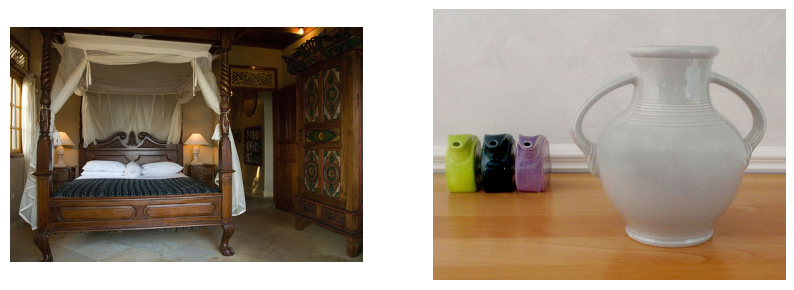

-------------------------------------------------------------------------------------- 
:: Pred: what color is the towel? :: Label: ['what is the color of the towel', 'who is on the towel', 'what color is the towel on the right'] 
 :: Context: [CLS] a bathroom with a sink, mirror, and shower. [SEP] and [SEP] a towel rack with a teddy bear and a towel. [SEP] 
 :: Bleu: 100.0 :: Meteor: 57.9221 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what is the color of the towel', 1], ['what is on the wall', -1], ['what color is the wall', -1], ['what room is the towel in', -1], ['who is on the towel', 1], ['what is behind the towel', -1], ['what is the towel put on ', -1], ['how many towels are there', -1], ['where was the photo taken', -1], ['where are the towels', -1], ['what color is the towel on the right', 1]]


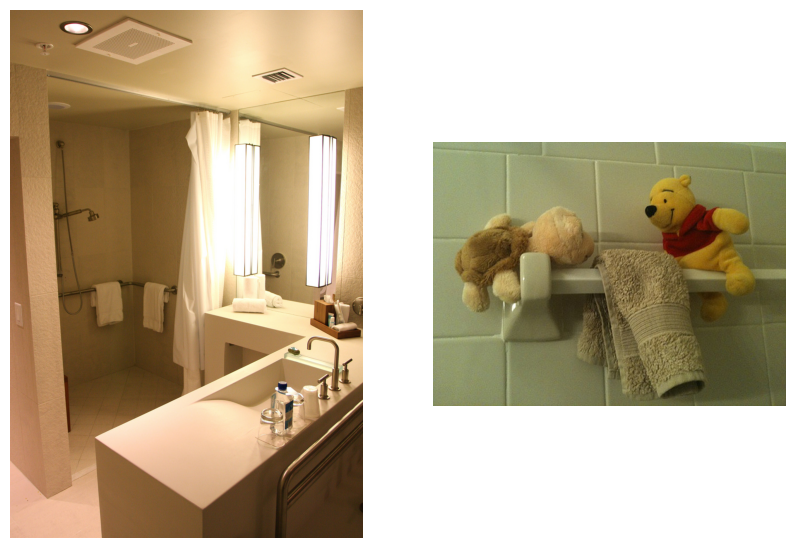

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['What is the gender of person', "What color is person's shirt", 'What is person holding'] 
 :: Context: [CLS] a man in a blue shirt and tie posing for a picture. [SEP] and [SEP] a woman wearing sunglasses holding a yellow umbrella. [SEP] 
 :: Bleu: 22.9575 :: Meteor: 73.5294 
 :: Delta BLEU: 20.66 ::
 :: Original questions :: [['What is the gender of person', 2], ["What color is person's shirt", 1], ['What is person holding', 1], ['what is the persion holding', 1], ['how many people are there', -1], ['what is the person wearing', 1]]


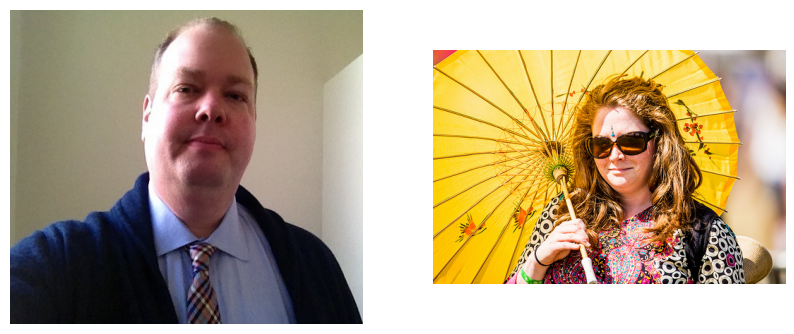

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['what is the shape of the cake', 'what color is the table', 'how many people are there in the picture'] 
 :: Context: [CLS] a little girl sitting in front of a chocolate cake. [SEP] and [SEP] two cakes sitting on a table with a knife and fork. [SEP] 
 :: Bleu: 100.0 :: Meteor: 64.6753 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['how many cakes are there', -1], ['what is the shape of the cake', 1], ['what color is the table', 1], ['what is on top of the cake', -1], ['What is cake on', -1], ['what is on the cake', -1], ['how many people are there in the picture', 1], ['where is the cake', -1], ['what is the cake made of', -1], ['what kind of cake is this', -1], ['what is the cake', -1]]


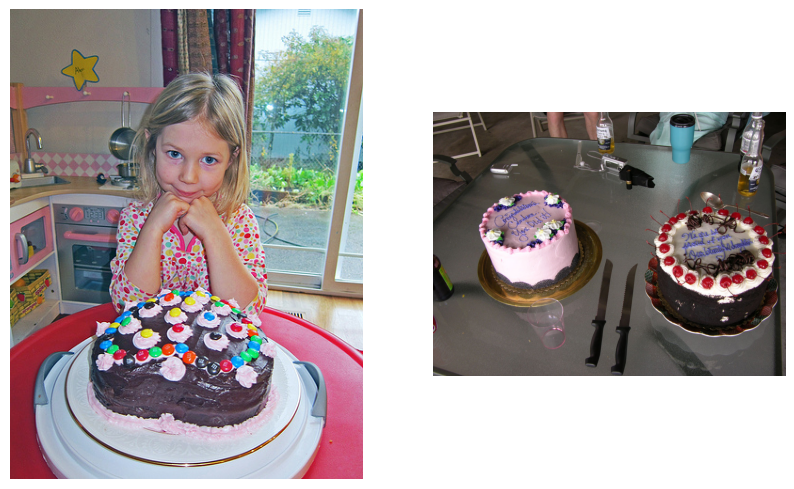

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['how many people are in the picture', 'what is the floor made of', 'what shape is the chair'] 
 :: Context: [CLS] a man standing in a living room holding a wii controller. [SEP] and [SEP] a kitchen with a table and chairs and a table. [SEP] 
 :: Bleu: 66.874 :: Meteor: 58.364 
 :: Delta BLEU: 71.58 ::
 :: Original questions :: [['what shape is the chair', 1], ['what is the floor the chair on made of', -1], ['what is on the chair', 1], ['how many chairs are there', 1], ['Where is the chair', -1], ['what is in the room', -1], ['how many people are in the picture', 2], ['what is the floor made of', 2]]


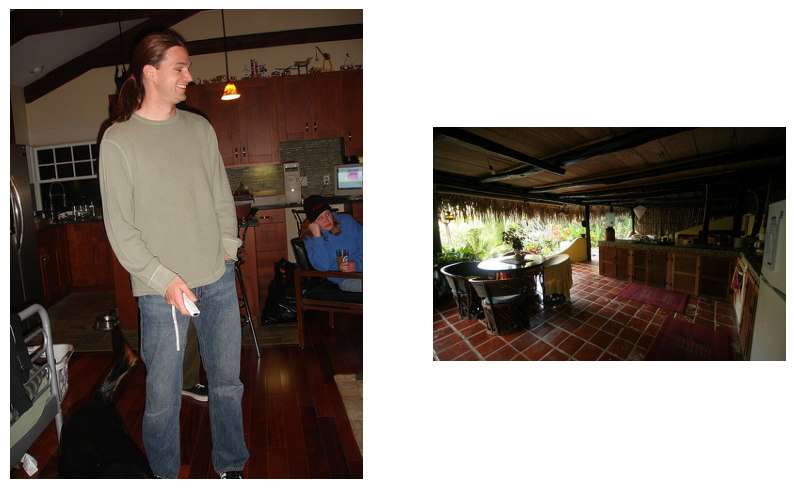

-------------------------------------------------------------------------------------- 
:: Pred: how many airplanes are there? :: Label: ['what color is the ground', 'what color is the plane', 'how many planes are in the picture'] 
 :: Context: [CLS] a blue and white airplane is on the runway. [SEP] and [SEP] a large jetliner flying over an airport. [SEP] 
 :: Bleu: 23.6435 :: Meteor: 37.5817 
 :: Delta BLEU: 16.72 ::
 :: Original questions :: [['what color is the plane', 1], ['what color is the ground', 2], ['how many planes are in the picture', 1], ['when is the picture taken', -1], ['where is the plane', -1], ['what is the ground covered with', 1], ["what color is the plane's tail", 1], ['what is the plane doing', -1], ['what is in the background', -1], ['where was this picture taken', -1], ['what is on the ground', -1]]


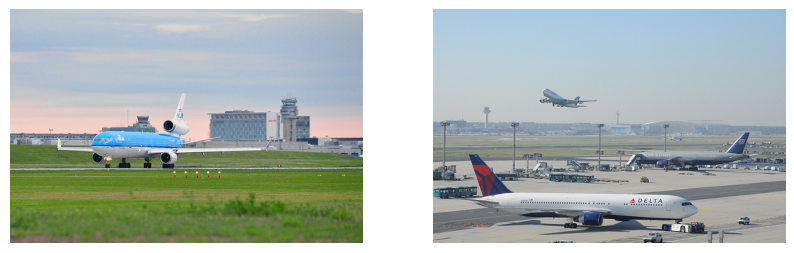

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['what color is the chair', 'what is on the chair', 'how many people are in the picture'] 
 :: Context: [CLS] a man sitting at a desk using a laptop. [SEP] and [SEP] a room with a row of tables and a laptop on top of it. [SEP] 
 :: Bleu: 66.874 :: Meteor: 58.364 
 :: Delta BLEU: 28.12 ::
 :: Original questions :: [['what is the chair made of', -1], ['what color is the chair', 2], ['what color is the ground', -1], ['how many chairs are there in the photo', -1], ['where is the chair', -1], ['what is on the chair', 1], ['how many people are in the picture', 1], ['what is the floor made of', -1], ['what is next to the chair', -1], ['what material is the chair made of', -1], ['where are the chairs', -1], ['what are the chairs made of', -1]]


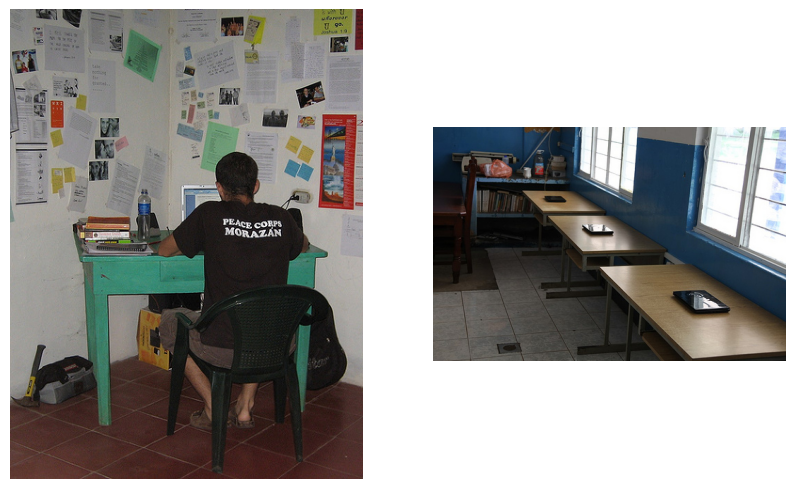

-------------------------------------------------------------------------------------- 
:: Pred: what color is the man's shirt? :: Label: ['where is the photo taken', 'How many people are there', 'What is man holding'] 
 :: Context: [CLS] a man holding an umbrella in the rain. [SEP] and [SEP] a man and woman smiling at a formal dinner. [SEP] 
 :: Bleu: 16.2334 :: Meteor: 36.7647 
 :: Delta BLEU: 9.65 ::
 :: Original questions :: [["What color is man's shirt", -1], ['How many people are there', 1], ['What is man holding', 1], ['where is the photo taken', 2], ['where are the people staying', 1], ['what is the persion holding', 1], ['what kind of shirt is the man wearing', 1], ["what is on the man's face", -1]]


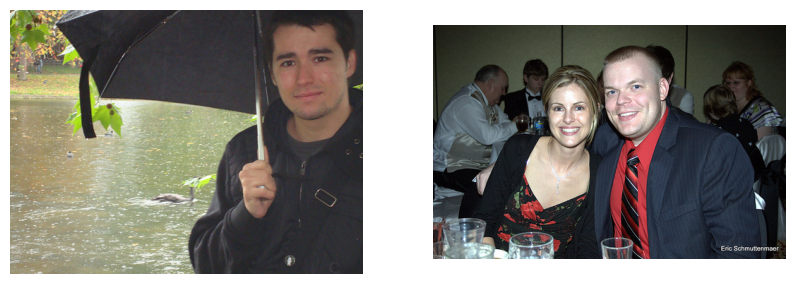

-------------------------------------------------------------------------------------- 
:: Pred: how many cars are there? :: Label: ['When is photo taken', 'what time is it', 'how many cars are there on the street'] 
 :: Context: [CLS] a street sign with a sticker on it [SEP] and [SEP] a red stop light at night with cars passing by. [SEP] 
 :: Bleu: 100.0 :: Meteor: 64.6753 
 :: Delta BLEU: 50.00 ::
 :: Original questions :: [['When is photo taken', 2], ['How mant people are there', -1], ['what is in front of the car', -1], ['how is the weather', -1], ['what time is it', 2], ['how many cars are there on the street', 1], ['where was this photo taken', -1], ['what is the road made of', -1], ['where are the cars', -1], ['what is on the ground', -1], ['when was the picture taken', 1]]


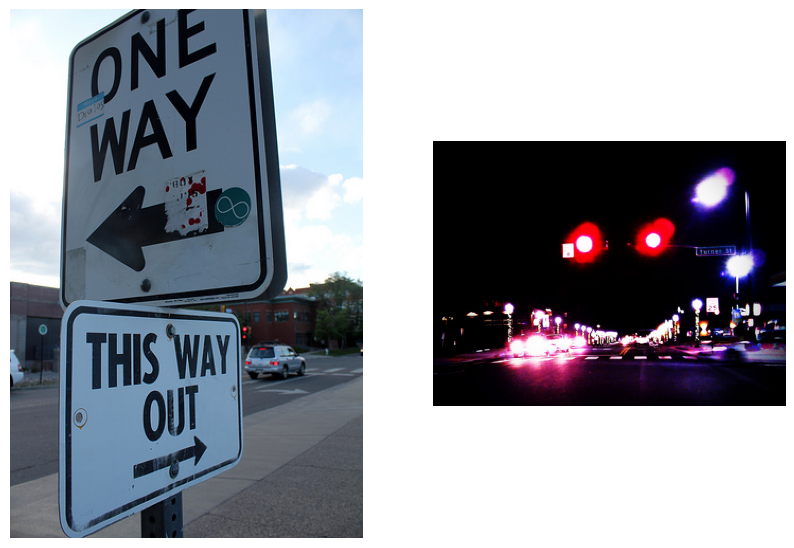

-------------------------------------------------------------------------------------- 
:: Pred: what color is the boy's shirt? :: Label: ['what is the woman wearing', "what is on woman's face", 'how many people are there'] 
 :: Context: [CLS] a young boy throwing a frisbee in a park. [SEP] and [SEP] a dog catching a frisbee in its mouth. [SEP] 
 :: Bleu: 17.9652 :: Meteor: 50.1089 
 :: Delta BLEU: 17.16 ::
 :: Original questions :: [['who is playing the disk', -1], ['what is the persion sitting on', -1], ["what is on woman's face", 1], ['how many people are there', 1], ['what is the woman doing', -1], ['what is the woman holding', 1], ['when was this photo taken', -1], ['what kind of pants is the woman wearing', -1], ['where was the photo taken', -1], ['who is wearing a white shirt', -1], ['what is the woman wearing', 2]]


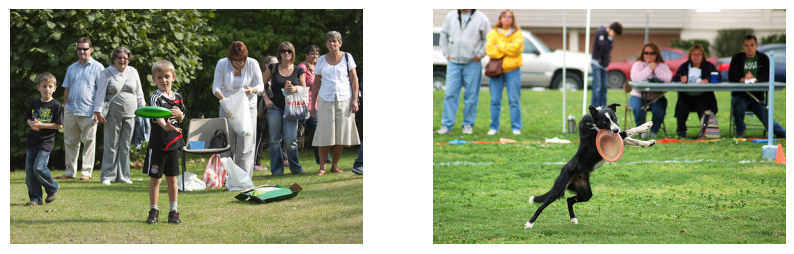

-------------------------------------------------------------------------------------- 
:: Pred: what is the man doing? :: Label: ['what is the woman wearing', 'what is the woman doing', 'where is the woman'] 
 :: Context: [CLS] a person riding a horse in a corral. [SEP] and [SEP] a man pulling a boat on the beach. [SEP] 
 :: Bleu: 42.7287 :: Meteor: 75.0 
 :: Delta BLEU: 50.81 ::
 :: Original questions :: [['what is the woman wearing', 1], ['what is the woman doing', 1], ['how many people are there', -1], ['where is the woman', 1], ['what gesture is the woman', -1], ['what is the woman holding', 1], ['when was the photo taken', -1], ['who is in the picture', -1], ['what is on the back of the woman', 1], ['what is the woman on', 1]]


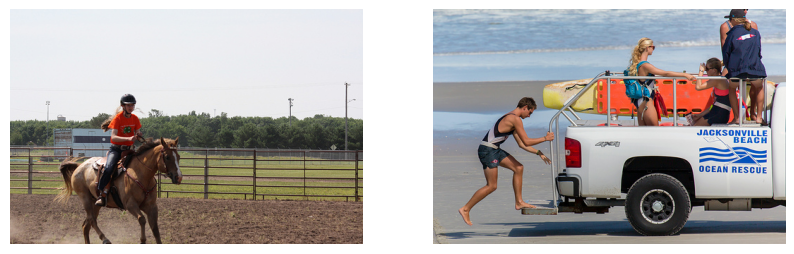

-------------------------------------------------------------------------------------- 
:: Pred: what color is the bench? :: Label: ['what color is the bench', 'what is the bench on', 'what is behind the bench'] 
 :: Context: [CLS] a blue book on a bench [SEP] and [SEP] a little boy jumping on a bench in a park. [SEP] 
 :: Bleu: 100.0 :: Meteor: 99.6 
 :: Delta BLEU: 100.00 ::
 :: Original questions :: [['what color is the bench', 2], ['what is the bench on', 1], ['who is on the bench', -1], ['when is this photo taken', -1], ['where is the bench', -1], ['what is behind the bench', 1], ['what is the bench made of', -1], ['how many benches are there', -1], ['what is on the bench', 1], ['what is made of wood', -1], ['what is in front of the bench', -1], ['what is under the bench', 1]]


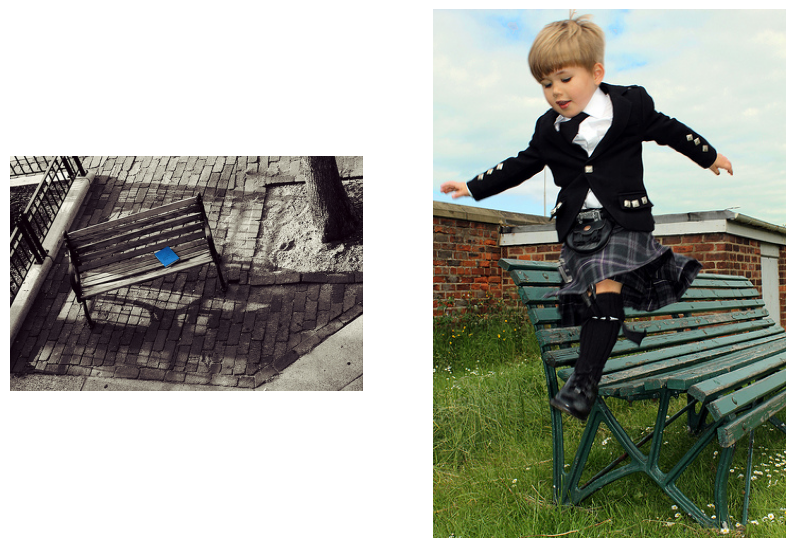

-------------------------------------------------------------------------------------- 
:: Pred: how many people are there? :: Label: ['where is the picture taken', "what is on the man's face", 'what color is the shirt'] 
 :: Context: [CLS] a man is using a laptop in a kitchen. [SEP] and [SEP] two men sitting at a table with a plate of food. [SEP] 
 :: Bleu: 5.3411 :: Meteor: 0.0 
 :: Delta BLEU: 50.00 ::
 :: Original questions :: [['what color is the shirt', 1], ['where is the picture taken', 2], ['how many faces are there in the picture', 1], ['What is the man doing', 1], ['what is the person holding', 1], ['where is the person', 1], ['how many people are there', 1], ["what color is the man's shirt", 1], ["what is on the man's face", 2], ['who is in the photo', -1]]


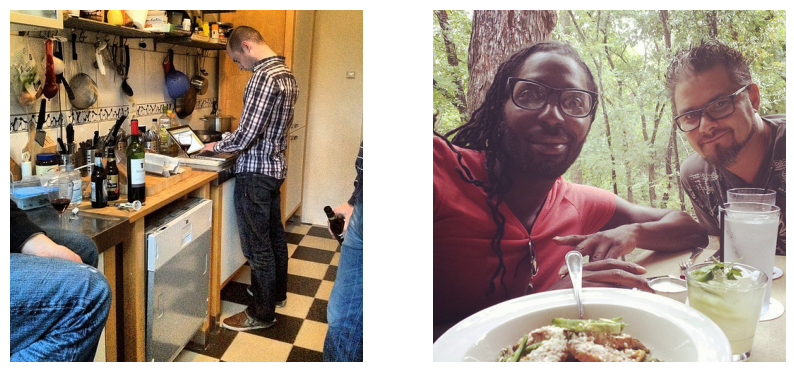

-------------------------------------------------------------------------------------- 
:: Pred: what color is the pillow? :: Label: ["what color is the woman's hair", 'where is the woman', 'how many people are there in the picture'] 
 :: Context: [CLS] a restaurant with a menu on the wall. [SEP] and [SEP] a woman laying on a bed with a pillow. [SEP] 
 :: Bleu: 66.874 :: Meteor: 67.2669 
 :: Delta BLEU: 66.87 ::
 :: Original questions :: [["what color is the woman's hair", 2], ['where is the woman', 2], ['what color is the background', 1], ['How many people are there', 1], ['What is woman holding', -1], ['what is the woman wearing', -1], ["what is the woman's posture", 1], ['who is in the photo', 1], ['what is the persion doing', 1], ['how many people are there in the picture', 2]]


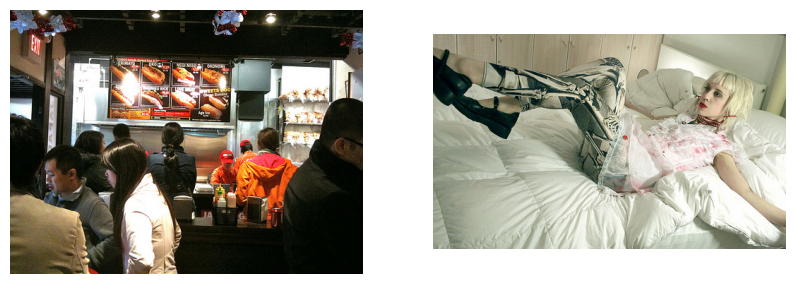

-------------------------------------------------------------------------------------- 
:: Pred: what is the color of the floor? :: Label: ['what shape is the clock', 'what is the clock on', 'what color is the clock'] 
 :: Context: [CLS] a door is open [SEP] and [SEP] an apple with a clock attached to it. [SEP] 
 :: Bleu: 26.2691 :: Meteor: 49.1453 
 :: Delta BLEU: 20.56 ::
 :: Original questions :: [['what is the clock on', 1], ['what shape is the clock', 2], ['what color is the clock', 1], ['how many people are there in the picture', -1], ['when is this picture taken', -1], ['where is the clock', 1], ['what time is showed on the clock', 1], ['what is the clock made of', 1], ['what time is it', 1], ['what is in the background', -1]]


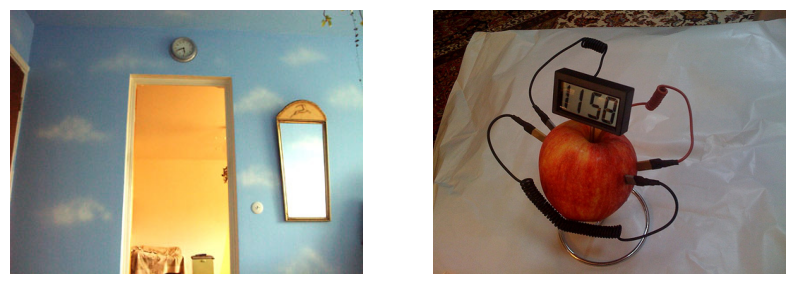

BLEU score:  47.7952
Average METEOR score:  56.0588
Delta BLEU score:  49.3141


In [10]:
# qg.calc_delta_bleu(prediction_sentence_list)
# qg.eval_prediction(prediction_sentence_list)
# context, prediction_sentence, question, image_1, image_2, questions_w_label = payload
visualize_preds(prediction_sentence_list, qg)

bleu_score, avg_meteor_Score, delta_bleu_score = qg.eval_prediction(prediction_sentence_list)

print("BLEU score: ", bleu_score)
print("Average METEOR score: ", avg_meteor_Score)
print("Delta BLEU score: ", delta_bleu_score)